In [131]:
# import the dataset from sklearn
from sklearn.datasets import fetch_20newsgroups
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# import other required libs
import pandas as pd
import numpy as np

# string manipulation libs
import re
import string
import nltk
from nltk.corpus import stopwords

# viz libs
import matplotlib.pyplot as plt
import seaborn as sns

In [132]:
import fitz
import os
import csv
import re

MAX_PUBLICATIONS = 5000 # total 10632

def load_data(path_to_dir, year=0):
    count = 0

    # clear data files
    with open(f'{year}_data.csv', mode='w', newline='') as f:
        f.write('')
    with open('articleIds.txt', mode='w', newline='') as f:
        f.write('')

    data = {}
    data['raw'] = []
    result_ids = []
    p = re.compile(r'\d{4}$')
    for dirpath, dirnames, filenames in os.walk(path_to_dir):
        if re.search(p, dirpath):
            y = dirpath[-4:]
            if y == str(year) or str(0) == str(year):
                for filename in [f for f in filenames if f.endswith('.pdf')]:
                    text = ""
                    try:
                        doc = fitz.open(dirpath + '/' + filename)
                        for page in doc:
                            text += page.getText(flags=0) + " "
                        # text = filter_symbols(text)
                    except:
                        print(f'no fulltext for: {filename}')

                    text = text.replace('International Joint Conference on Artificial Intelligence', ' ')
                    text = text.replace('-\n', '')
                    text = text.replace('\n', ' ')
                    data['raw'].append(text.lower())
                    result_ids.append(filename[:-4])

                    with open(f'{year}_data.csv', 'a', newline='') as csvfile:
                        csvwriter = csv.writer(csvfile, delimiter=',', quotechar='"', quoting=csv.QUOTE_MINIMAL)
                        csvwriter.writerow([text.lower()])
                    with open('articleIds.txt', mode='a', newline='') as f:
                        f.write(filename[:-4] + '\n')

                    if count % 10 == 0:
                        percent = (count / MAX_PUBLICATIONS) * 100
                        print("load data: " + str(round(percent, 2)) + " %")
                    count += 1

                    if len(data['raw']) >= MAX_PUBLICATIONS:
                        break
                else:
                    continue
                break
        else:
            continue
        break
    return data, result_ids


data, result_ids = load_data("../../data/backup/fulltext")

load data: 0.0 %
load data: 0.2 %
load data: 0.4 %
load data: 0.6 %
load data: 0.8 %
load data: 1.0 %
load data: 1.2 %
load data: 1.4 %
load data: 1.6 %
load data: 1.8 %
load data: 2.0 %
load data: 2.2 %
load data: 2.4 %
load data: 2.6 %
load data: 2.8 %
load data: 3.0 %
load data: 3.2 %
load data: 3.4 %
load data: 3.6 %
load data: 3.8 %
load data: 4.0 %
load data: 4.2 %
load data: 4.4 %
load data: 4.6 %
load data: 4.8 %
load data: 5.0 %
load data: 5.2 %
load data: 5.4 %
load data: 5.6 %
load data: 5.8 %
load data: 6.0 %
load data: 6.2 %
load data: 6.4 %
load data: 6.6 %
load data: 6.8 %
load data: 7.0 %
load data: 7.2 %
load data: 7.4 %
load data: 7.6 %
load data: 7.8 %
load data: 8.0 %
load data: 8.2 %
load data: 8.4 %
load data: 8.6 %
load data: 8.8 %
load data: 9.0 %
load data: 9.2 %
load data: 9.4 %
load data: 9.6 %
load data: 9.8 %
load data: 10.0 %
load data: 10.2 %
load data: 10.4 %
load data: 10.6 %
load data: 10.8 %
load data: 11.0 %
load data: 11.2 %
load data: 11.4 %
load d

mupdf: cmsOpenProfileFromMem failed


load data: 79.0 %


mupdf: cmsOpenProfileFromMem failed
mupdf: cmsOpenProfileFromMem failed


load data: 79.2 %
load data: 79.4 %
load data: 79.6 %
load data: 79.8 %
load data: 80.0 %
load data: 80.2 %
load data: 80.4 %
load data: 80.6 %
load data: 80.8 %
load data: 81.0 %
load data: 81.2 %
load data: 81.4 %
load data: 81.6 %
load data: 81.8 %
load data: 82.0 %
load data: 82.2 %
load data: 82.4 %
load data: 82.6 %
load data: 82.8 %
load data: 83.0 %
load data: 83.2 %
load data: 83.4 %
load data: 83.6 %
load data: 83.8 %
load data: 84.0 %
load data: 84.2 %
load data: 84.4 %
load data: 84.6 %
load data: 84.8 %
load data: 85.0 %
load data: 85.2 %
load data: 85.4 %
load data: 85.6 %
load data: 85.8 %
load data: 86.0 %
load data: 86.2 %
load data: 86.4 %
load data: 86.6 %
load data: 86.8 %
load data: 87.0 %
load data: 87.2 %
load data: 87.4 %
load data: 87.6 %
load data: 87.8 %
load data: 88.0 %
load data: 88.2 %
load data: 88.4 %
load data: 88.6 %
load data: 88.8 %
load data: 89.0 %
load data: 89.2 %
load data: 89.4 %
load data: 89.6 %
load data: 89.8 %
load data: 90.0 %
load data:

In [133]:
data


{'raw': ['dp-slam: fast, robust simultaneous localization and mapping without  predetermined landmarks  austin eliazar and ronald parr  department of computer science  duke university  {eliazar, parr} @cs.duke.edu  abstract  we present a novel, laser range finder based algorithm  for simultaneous localization and mapping (slam) for  mobile robots. slam addresses the problem of constructing an accurate map in real time despite imperfect  information about the robot\'s trajectory through the environment. unlike other approaches that assume predetermined landmarks (and must deal with a resulting dataassociation problem) our algorithm is purely laser based.  our algorithm uses a particle filter to represent both robot  poses and possible map configurations. by using a new  map representation, which we call distributed particle  (dp) mapping, we are able to maintain and update hundreds of candidate maps and robot poses efficiently. the  worst-case complexity of our algorithm per laser sweep

In [134]:
df = pd.DataFrame(data['raw'], columns=['corpus'])

In [135]:
def preprocess_text(text: str, remove_stopwords: bool) -> str:
    """This utility function sanitizes a string by:
    - removing links
    - removing special characters
    - removing numbers
    - removing stopwords
    - transforming in lowercase
    - removing excessive whitespaces
    Args:
        text (str): the input text you want to clean
        remove_stopwords (bool): whether or not to remove stopwords
    Returns:
        str: the cleaned text
    """

    # remove links
    text = re.sub(r"http\S+", "", text)
    # remove special chars and numbers
    text = re.sub("[^A-Za-z]+", " ", text)
    # remove stopwords
    if remove_stopwords:
        # 1. tokenize
        tokens = nltk.word_tokenize(text)
        # 2. check if stopword
        tokens = [w for w in tokens if not w.lower() in stopwords.words("english")]
        # 3. join back together
        text = " ".join(tokens)
    # return text in lower case and stripped of whitespaces
    text = text.lower().strip()
    return text

In [136]:
import time
start = time.time()

df['cleaned'] = df['corpus'][:MAX_PUBLICATIONS].apply(lambda x: preprocess_text(x, remove_stopwords=True))
end = time.time()
t = (end - start) / 60
print("Cleaned :) It took " + str(t) + " minutes.")
print()

Cleaned :) It took 30.30481702486674 minutes.



In [137]:
start = time.time()

# initialize the vectorizer
vectorizer = TfidfVectorizer(sublinear_tf=True, min_df=5, max_df=0.95)
# fit_transform applies TF-IDF to clean texts - we save the array of vectors in X
X = vectorizer.fit_transform(df['cleaned'][:MAX_PUBLICATIONS])

end = time.time()
t = (end - start) / 60
print("Vectors are created. It took " + str(t) + " minutes.")
print()

Vectors are created. It took 0.11464813550313314 minutes.



In [138]:
from sklearn.cluster import KMeans

start = time.time()
# initialize kmeans with 3 centroids
kmeans = KMeans(n_clusters=3, random_state=42)
# fit the model
kmeans.fit(X)
# store cluster labels in a variable
clusters = kmeans.labels_

end = time.time()
t = (end - start) / 60
print("K-MEANS. It took " + str(t) + " minutes.")
print()

K-MEANS. It took 0.10174210866292317 minutes.



In [139]:
start = time.time()

from sklearn.decomposition import PCA

# initialize PCA with 2 components
pca = PCA(n_components=2, random_state=42)
# pass our X to the pca and store the reduced vectors into pca_vecs
pca_vecs = pca.fit_transform(X.toarray())
# save our two dimensions into x0 and x1
x0 = pca_vecs[:, 0]
x1 = pca_vecs[:, 1]


end = time.time()
t = (end - start) / 60
print("PCA. It took " + str(t) + " minutes.")
print()

PCA. It took 0.2939163088798523 minutes.



In [140]:
# assign clusters and pca vectors to our dataframe
df['cluster'] = clusters
df['x0'] = x0
df['x1'] = x1

In [141]:
def get_top_keywords(n_terms):
    """This function returns the keywords for each centroid of the KMeans"""
    df = pd.DataFrame(X.todense()).groupby(clusters).mean() # groups the TF-IDF vector by cluster
    terms = vectorizer.get_feature_names_out() # access tf-idf terms
    cluster_map = {}
    for i,r in df.iterrows():
        print('\nCluster {}'.format(i))
        print(','.join([terms[t] for t in np.argsort(r)[-n_terms:]])) # for each row of the dataframe, find the n terms that have the highest tf idf score
        cluster_map[str(i)] = ','.join([terms[t] for t in np.argsort(r)[-n_terms:]])
    return cluster_map
cluster_map = get_top_keywords(10)
cluster_map


Cluster 0
rules,must,set,new,example,may,used,language,knowledge,system

Cluster 1
time,problem,pages,theorem,algorithm,agent,let,set,al,et

Cluster 2
performance,datasets,matrix,neural,data,dataset,training,al,et,learning


{'0': 'rules,must,set,new,example,may,used,language,knowledge,system',
 '1': 'time,problem,pages,theorem,algorithm,agent,let,set,al,et',
 '2': 'performance,datasets,matrix,neural,data,dataset,training,al,et,learning'}

In [142]:
# apply mapping
df['cluster_map'] = df['cluster'].map(cluster_map)

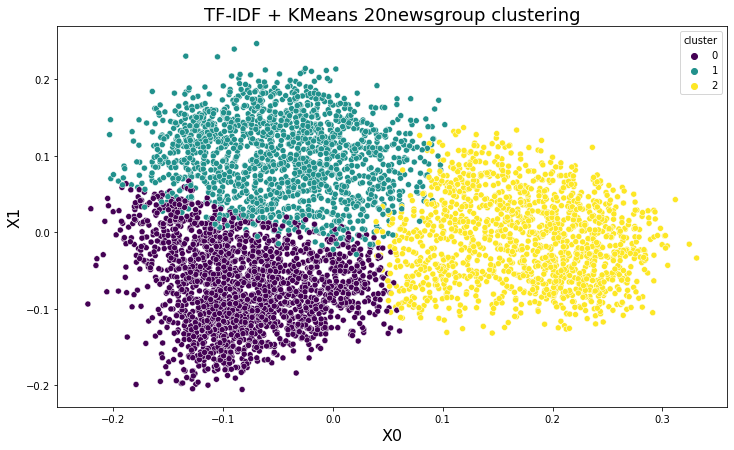

In [143]:
# set image size
plt.figure(figsize=(12, 7))
# set a title
plt.title("TF-IDF + KMeans 20newsgroup clustering", fontdict={"fontsize": 18})
# set axes names
plt.xlabel("X0", fontdict={"fontsize": 16})
plt.ylabel("X1", fontdict={"fontsize": 16})
# create scatter plot with seaborn, where hue is the class used to group the data
sns.scatterplot(data=df, x='x0', y='x1', hue='cluster', palette="viridis")
plt.show()